In [1]:
!pip install gymnasium==0.29.1
!pip install torch==2.4.1
!pip install swig
!pip install gymnasium[box2d]

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 953.9/953.9 kB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 797.1/797.1 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 77.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 62.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 38.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.2/176.2 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
import gymnasium as gym
import numpy as np
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

from torch.nn import functional as F
from matplotlib.animation import FuncAnimation

import random

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
gamma = 0.99
n_episodes = 2000

In [12]:
def get_average_reward(reward):
    average_reward = []

    for idx in range(len(reward)):
        avg_list = np.empty(shape=(1,), dtype=int)
        if idx < 50:
            avg_list = reward[:idx+1]
        else:
            avg_list = reward[idx-49:idx+1]
        average_reward.append(np.average(avg_list))

    return average_reward

## Actor-critic

### Actor and critic networks

In [4]:
class ActorNetwork(nn.Module):
    def __init__(self, state_dim, action_dim, hidden_dim):
        super(ActorNetwork, self).__init__()
        self.fc1 = nn.Linear(state_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, action_dim)

    def forward(self, state):
        x = F.relu(self.fc1(state))
        logits = self.fc2(x)
        return logits

    def get_action(self, state):
        with torch.no_grad():
            logits = self.forward(state)
            probs = torch.softmax(logits, dim=-1)
            action = torch.multinomial(probs, 1)
            return action.item()

class CriticNetwork(nn.Module):
    def __init__(self, state_dim, hidden_dim):
        super(CriticNetwork, self).__init__()
        self.fc1 = nn.Linear(state_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, 1)

    def forward(self, state):
        x = F.relu(self.fc1(state))
        state_value = self.fc2(x)
        return state_value


### Bootstrapping

In [5]:
def compute_n_step_returns(rewards, values, gamma, n_steps):
    returns = np.zeros(len(rewards))
    episode_length = len(rewards)

    for t in range(episode_length):
        G_t = 0.0
        current_discount = 1.0  # Starts at 1, then we multiply it by gamma at each time step for discounting.

        for k in range(n_steps):
            current_step = t + k

            # We stop if the episode has finished.
            if current_step >= episode_length:
                break

            G_t += current_discount * rewards[current_step]
            current_discount *= gamma

        # We only estimate the remaining value using bootstrapping if the episode has not finished.
        if t + n_steps < episode_length:
            G_t += current_discount * values[t + n_steps]

        returns[t] = G_t

    return returns

### Training loop

In [14]:
env = gym.make("CartPole-v1")

# intialize critic and actor networks
state_dim = 4
action_dim = 2
hidden_dim = 64

actor = ActorNetwork(state_dim=state_dim, action_dim=action_dim, hidden_dim=hidden_dim).to(device)
critic = CriticNetwork(state_dim=state_dim, hidden_dim=hidden_dim).to(device)

# define hyperparameters
n_steps = 50
gamma = 0.99
n_episodes = 1500
actor_lr = 1e-3
critic_lr = 1e-2

In [ ]:
def train_a2c(env, n_steps, gamma, n_episodes, actor, critic, actor_optimizer, critic_optimizer, max_grad_norm=0.5):
    total_rewards = []
    cum_rewards_per_episode = []

    for i in range(n_episodes):
        # Run episode till done
        done = False
        states = []
        actions = []
        rewards = []
        s, _ = env.reset()

        while not done:
            states.append(s.tolist())
            a = actor.get_action(torch.tensor(s, dtype=torch.float).to(device))
            s, r, term, trunc, _ = env.step(a)
            done = term or trunc
            actions.append(a)
            rewards.append(r)

        # Get cumulative rewards
        cum_rewards = np.zeros_like(rewards)
        reward_len = len(rewards)
        for j in reversed(range(reward_len)):
            cum_rewards[j] = rewards[j] + (cum_rewards[j+1]*gamma if j+1 < reward_len else 0)
        cum_rewards_per_episode.append(cum_rewards)

        states = torch.tensor(states, dtype=torch.float).to(device)
        actions = torch.tensor(actions, dtype=torch.int64).to(device)
        cum_rewards = torch.tensor(cum_rewards, dtype=torch.float).to(device)

        # n-steps returns computation
        estimated_values = critic(states)
        n_step_returns = compute_n_step_returns(rewards, torch.flatten(estimated_values).tolist(), gamma, n_steps)
        n_step_returns = torch.tensor(n_step_returns, dtype=torch.float).to(device)

        actor_optimizer.zero_grad()
        critic_optimizer.zero_grad()

        # Critic update
        # Gradient Descent update using MSE loss
        critic_loss = F.mse_loss(estimated_values, torch.unsqueeze(n_step_returns, 1))
        critic_loss.backward()
        torch.nn.utils.clip_grad_norm_(critic.parameters(), max_grad_norm)
        critic_optimizer.step()

        # Actor update
        logits = actor(states)
        log_probs = -F.cross_entropy(logits, actions, reduction="none")

        # Estimated values is of shape [n_transitions x 1], while n_step_returns is of shape [n_transitions].
        # So to correctly obtain a scalar value of advanage for each transition we have to squeeze the dimension 1 to match dimensions.
        advantages = (n_step_returns - torch.squeeze(estimated_values, 1)).detach()  # Detach to avoid backprop through critic
        advantages = (advantages - advantages.mean()) / (advantages.std() + 1e-8) # Stable-baseline normalizes the advantage for increasing stability
        actor_loss = -log_probs * advantages
        actor_loss.sum().backward()
        torch.nn.utils.clip_grad_norm_(actor.parameters(), max_grad_norm)
        actor_optimizer.step()

        # Record total rewards in episode
        total_rewards.append(sum(rewards))
        print("Run episode {} with rewards {}".format(i, sum(rewards)), end="\n")

    print("\nDone")
    env.close()

    return total_rewards, cum_rewards_per_episode

## Lunar Lander

In [ ]:
# lunar lander with discrete action space
env = gym.make('LunarLander-v2')

class DiscreteActorNetworkLunarLander(nn.Module):
    def __init__(self, state_dim, action_dim, hidden_dim):
        super(DiscreteActorNetworkLunarLander, self).__init__()
        self.fc1 = nn.Linear(state_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc3 = nn.Linear(hidden_dim, hidden_dim)
        self.fc4 = nn.Linear(hidden_dim, action_dim)

    def forward(self, state):
        x = F.relu(self.fc1(state))
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        logits = self.fc4(x)
        return logits

    def get_action(self, state):
        with torch.no_grad():
            logits = self.forward(state)
            probs = torch.softmax(logits, dim=-1)
            action = torch.multinomial(probs, 1)
            return action.item()

class CriticNetworkLunarLander(nn.Module):
    def __init__(self, state_dim, hidden_dim):
        super(CriticNetworkLunarLander, self).__init__()
        self.fc1 = nn.Linear(state_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)
        self.fc3 = nn.Linear(hidden_dim, 1)

    def forward(self, state):
        x = F.relu(self.fc1(state))
        x = F.relu(self.fc2(x))
        state_value = self.fc3(x)
        return state_value


In [ ]:
# Intialize critic and actor networks
state_dim = 8
action_dim = 4
hidden_dim = 64
actor = DiscreteActorNetworkLunarLander(state_dim=state_dim, action_dim=action_dim, hidden_dim=hidden_dim).to(device)
critic = CriticNetworkLunarLander(state_dim=state_dim, hidden_dim=hidden_dim).to(device)

# Define hyperparameters
n_steps = 30
gamma = 0.99
n_episodes = 5000
actor_lr = 1e-3
critic_lr = 4e-3

In [ ]:
actor_optimizer = torch.optim.Adam(actor.parameters(), lr=actor_lr)
critic_optimizer = torch.optim.Adam(critic.parameters(), lr=critic_lr)
a2c_total_rewards, cum_rewards_per_episode = train_a2c(env, n_steps, gamma, n_episodes, actor, critic, actor_optimizer, critic_optimizer)

Streaming output truncated to the last 5000 lines.
Run episode 2 with rewards -452.8023407117161
Run episode 3 with rewards -141.3507370107872
Run episode 4 with rewards -98.18283082047257
Run episode 5 with rewards -405.2915199785457
Run episode 6 with rewards -84.91589856274041
Run episode 7 with rewards -136.7390780698022
Run episode 8 with rewards -221.45457361274953
Run episode 9 with rewards -115.92880259431607
Run episode 10 with rewards -317.8610684632174
Run episode 11 with rewards -257.8306378775711
Run episode 12 with rewards -143.25829446956203
Run episode 13 with rewards -224.06896909077133
Run episode 14 with rewards -150.99604591028984
Run episode 15 with rewards -75.5192736693342
Run episode 16 with rewards -91.32201619979779
Run episode 17 with rewards -210.50840219126215
Run episode 18 with rewards -206.66748551917777
Run episode 19 with rewards -204.24742291191612
Run episode 20 with rewards -164.3023799530303
Run episode 21 with rewards -379.3161425708227
Run episod

### Evaluation

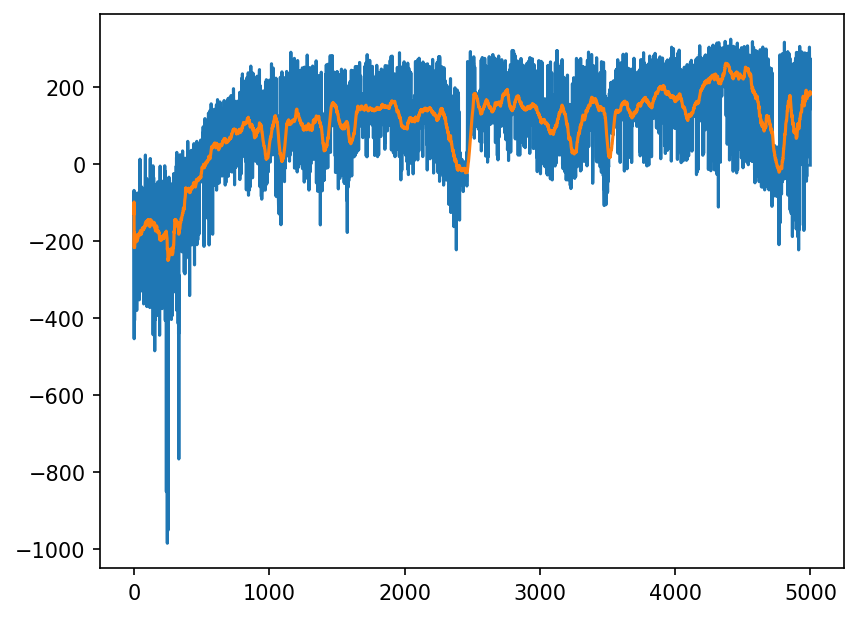

In [ ]:
plt.clf()
plt.plot(a2c_total_rewards)
plt.plot(get_average_reward(a2c_total_rewards))
plt.show()

### Demo

In [ ]:
eval_env = gym.make("LunarLander-v2", render_mode='rgb_array')

done = False
s, _ = eval_env.reset()
frames = []

while not done:
    a = actor.get_action(torch.tensor(s, dtype=torch.float).to(device))
    s, r, term, trunc, _ = eval_env.step(a)
    done = term or trunc
    frames.append(eval_env.render())

plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150
plt.ioff()
fig, ax = plt.subplots()

def animate(t):
    plt.cla()
    plt.imshow(frames[t])

FuncAnimation(fig, animate, frames=len(frames))

## Lunar Lander with Continuous Action Space

In [ ]:
# lunar lander with continuous action space
env = gym.make('LunarLander-v2', continuous=True)

class ContinuousActorNetworkLunarLander(nn.Module):
    def __init__(self, state_dim, action_dim, hidden_dim):
        super(ContinuousActorNetworkLunarLander, self).__init__()
        self.fc1 = nn.Linear(state_dim, hidden_dim)
        self.fc2 = nn.Linear(hidden_dim, hidden_dim)

                                                                # Two heads actor policy: predicts both mean and log standard deviation
        self.mean_layer = nn.Linear(hidden_dim, action_dim)     # Output layer for mean
        self.log_std_layer = nn.Linear(hidden_dim, action_dim)  # Output layer for log standard deviation

    def forward(self, state):
        x = F.relu(self.fc1(state))
        x = F.relu(self.fc2(x))

        mean = self.mean_layer(x)
        log_std = self.log_std_layer(x)
        log_std = torch.clamp(log_std, min=-20, max=2)  # We clamp log_std to not vanish or explode, since it would be cause of numerical errors
        return mean, log_std

    def get_action(self, state):
        with torch.no_grad():
            mean, log_std = self.forward(state)
            std = torch.exp(log_std)  # Our network learns to output a log_std, so we convert it to std by exponentiation

            normal_dist = torch.distributions.Normal(mean, std)
            action = normal_dist.sample()

            return action.cpu().numpy()

In [ ]:
# intialize critic and actor networks
state_dim = 8
action_dim = 2
hidden_dim = 64

actor = ContinuousActorNetworkLunarLander(state_dim=state_dim, action_dim=action_dim, hidden_dim=hidden_dim).to(device)
critic = CriticNetworkLunarLander(state_dim=state_dim, hidden_dim=hidden_dim).to(device)

# define hyperparameters
n_steps = 30
gamma = 0.99
n_episodes = 6000
actor_lr = 3e-4
critic_lr = 1e-3

In [ ]:
def train_a2c_continuous(env, n_steps, gamma, n_episodes, actor, critic, actor_optimizer, critic_optimizer, max_grad_norm=0.5):
    total_rewards = []
    cum_rewards_per_episode = []

    for i in range(n_episodes):
        # Initialize variables for each episode
        done = False
        states = []
        actions = []
        rewards = []
        s, _ = env.reset()

        while not done:
            states.append(s.tolist())
            s_tensor = torch.tensor(s, dtype=torch.float).to(device)
            action = actor.get_action(s_tensor)
            s, r, term, trunc, _ = env.step(action)
            done = term or trunc

            actions.append(action)
            rewards.append(r)

        # Calculate cumulative rewards for the episode (using discounted rewards)
        cum_rewards = np.zeros_like(rewards)
        reward_len = len(rewards)
        for j in reversed(range(reward_len)):
            cum_rewards[j] = rewards[j] + (cum_rewards[j+1]*gamma if j+1 < reward_len else 0)
        cum_rewards_per_episode.append(cum_rewards)

        states = torch.tensor(states, dtype=torch.float).to(device)
        actions = torch.tensor(actions, dtype=torch.float).to(device)

        # Calculate n-step returns for critic update
        estimated_values = critic(states)
        n_step_returns = compute_n_step_returns(rewards, torch.flatten(estimated_values).tolist(), gamma, n_steps)
        n_step_returns = torch.tensor(n_step_returns, dtype=torch.float).to(device)

        actor_optimizer.zero_grad()
        critic_optimizer.zero_grad()

        # Critic update
        critic_loss = F.mse_loss(estimated_values, torch.unsqueeze(n_step_returns, 1), reduction="sum")
        critic_loss.backward()
        torch.nn.utils.clip_grad_norm_(critic.parameters(), max_grad_norm)
        critic_optimizer.step()

        # Actor update
        mean, log_std = actor(states)
        std = torch.exp(log_std)
        normal_dist = torch.distributions.Normal(mean, std)
        log_probs = normal_dist.log_prob(actions).sum(dim=-1)  # Sum over action dimensions

        # Squeeze for matching dimensions. See train_a2c function
        # Detach to avoid backpropagation through critic.
        advantages = (n_step_returns - torch.squeeze(estimated_values, 1)).detach()
        advantages = (advantages - advantages.mean()) / (advantages.std() + 1e-8) # Stable-baseline normalizes the advantage for increasing stability
        actor_loss = -log_probs * advantages
        actor_loss.sum().backward()
        torch.nn.utils.clip_grad_norm_(actor.parameters(), max_grad_norm)
        actor_optimizer.step()

        # Record total reward for the episode
        total_rewards.append(sum(rewards))
        print("Run episode {} with rewards {}".format(i, sum(rewards)), end="\n")

    print("\nDone")
    env.close()

    return total_rewards, cum_rewards_per_episode

In [ ]:
actor_optimizer = torch.optim.Adam(actor.parameters(), lr=actor_lr)
critic_optimizer = torch.optim.Adam(critic.parameters(), lr=critic_lr)
a2c_total_rewards, cum_rewards_per_episode = train_a2c_continuous(env, n_steps, gamma, n_episodes, actor, critic, actor_optimizer, critic_optimizer)

Streaming output truncated to the last 5000 lines.
Run episode 1002 with rewards -67.19047036760878
Run episode 1003 with rewards -53.434056764341
Run episode 1004 with rewards -85.66605353770794
Run episode 1005 with rewards -282.80377134511343
Run episode 1006 with rewards -8.405289180938567
Run episode 1007 with rewards -175.89067190894656
Run episode 1008 with rewards -17.80951884934035
Run episode 1009 with rewards -1.8219196724364934
Run episode 1010 with rewards -107.84489284861071
Run episode 1011 with rewards -119.48997546546082
Run episode 1012 with rewards -139.34592224114274
Run episode 1013 with rewards -40.47908464888776
Run episode 1014 with rewards -67.57946778860926
Run episode 1015 with rewards 5.771792973290957
Run episode 1016 with rewards -8.719165641272596
Run episode 1017 with rewards -283.669849005148
Run episode 1018 with rewards -87.14900794453261
Run episode 1019 with rewards -61.32588810202448
Run episode 1020 with rewards -204.45640717182368
Run episode 102

### Evaluation

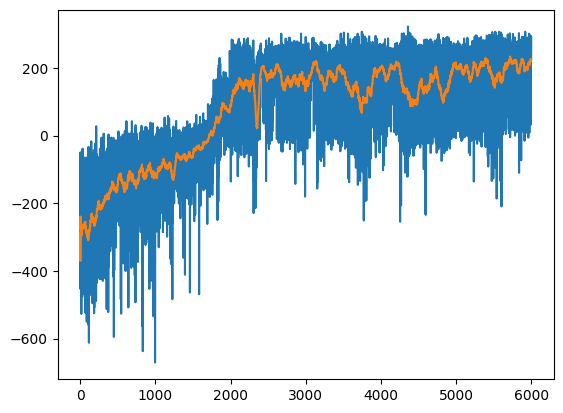

In [ ]:
plt.clf()
plt.plot(a2c_total_rewards)
plt.plot(get_average_reward(a2c_total_rewards))
plt.show()

### Demo

In [ ]:
eval_env = gym.make("LunarLander-v2", continuous=True, render_mode='rgb_array')

done = False
s, _ = eval_env.reset()
frames = []

while not done:
    a = actor.get_action(torch.tensor(s, dtype=torch.float).to(device))
    s, r, term, trunc, _ = eval_env.step(a)
    done = term or trunc
    frames.append(eval_env.render())

plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150
plt.ioff()
fig, ax = plt.subplots()

def animate(t):
    plt.cla()
    plt.imshow(frames[t])

FuncAnimation(fig, animate, frames=len(frames))